In [1]:
 ####### Setup
import os
import matplotlib.pyplot as plt
from matplotlib.tri import Triangulation
from matplotlib.patches import Patch
from matplotlib.patches import Rectangle
from matplotlib.lines import Line2D
from matplotlib.offsetbox import OffsetImage,AnnotationBbox,TextArea
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cv2
from scipy import stats
from sklearn.linear_model import LinearRegression
from sklearn import preprocessing
while os.getcwd().split('\\')[-1] != 'ecological-networks':
    %cd ..
import setup_paths
setup_paths.add_path()
from Species_Reintroductions import *
global DATA_TYPE
DATA_TYPE = 'Real_2D'
CASE_TO_SOLVE_init(DATA_TYPE)
get_CASE()

def CASE_init(CASE_TO_SOLVE):
    DATA_TYPE = CASE_TO_SOLVE
    CASE_TO_SOLVE_init(DATA_TYPE)
    NetworkName_Solved_df = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '01_Simulation_Execution', f"Network_Solved_{DATA_TYPE.split('_')[0]}.pkl"))
    M = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '01_Simulation_Execution', f"M_{DATA_TYPE.split('_')[0]}.pkl"))
    if DATA_TYPE.split('_')[0] == 'Syn':
        M = {k:M[k] for k in M.keys() if int(k.split('_')[2]) == 100}
    return DATA_TYPE, NetworkName_Solved_df, M

def init_HeatmapData(Case, Start = 0, End = -1):
    if End == -1:
        End = Start + 1
    if Case == 1:
        Heatmap01_All = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '02_Generate_Database', f"Heatmap01_{DATA_TYPE}.pkl"))
        return {k:Heatmap01_All[k][Start:End] for k in Heatmap01_All.keys()}
    if Case == 2:
        Heatmap02_All = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '02_Generate_Database', f"Heatmap02_{DATA_TYPE}.pkl"))
        return {k:Heatmap02_All[k][Start:End] for k in Heatmap02_All.keys()}
    if Case == 3:
        Heatmap03_All = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '02_Generate_Database', f"Heatmap03_{DATA_TYPE}.pkl"))
        return {k:Heatmap03_All[k][Start:End] for k in Heatmap03_All.keys()}

d:\Github\ecological-networks\Code\01_Species_Reintroductions
d:\Github\ecological-networks\Code
d:\Github\ecological-networks
Real_2D


# Latest Heatmap

In [2]:
from matplotlib import cm
import matplotlib as mpl
norm = mpl.colors.Normalize(vmin=0, vmax=4)
rgba_color = cm.viridis(norm(2))
c = [cm.viridis(norm(i)) for i in range(5)]

In [14]:
Placeholder = 'Real'
Form = 1
cmap = {i:mpl.cm.viridis(norm(i)) if i != 2 else 'orange' for i in range(5)}
norm = mpl.colors.Normalize(vmin=0, vmax=4)

fig, ax = plt.subplots(1,3,figsize = (35,10), sharex = True, dpi = 600)
fig.tight_layout(pad=5)

X = [UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '06_Figures', 'Final_Mask_Real_1D.pkl')),
     UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '06_Figures', 'Final_Mask_Real_2D.pkl'))]

X_1d, X_2d = X

unique, counts = np.unique(X_1d[:,0:9], return_counts=True)
X_1d_abundance = {i: counts[np.where(unique == i)[0][0]] if i in unique else 0 for i in range(5)}
unique, counts = np.unique(X_1d[:,9:18], return_counts=True)
X_1d_settlingtime = {i: counts[np.where(unique == i)[0][0]] if i in unique else 0 for i in range(5)}
unique, counts = np.unique(X_1d[:,18:27], return_counts=True)
X_1d_persistence = {i: counts[np.where(unique == i)[0][0]] if i in unique else 0 for i in range(5)}
unique, counts = np.unique(X_2d[:,0:9], return_counts=True)
X_2d_abundance = {i: counts[np.where(unique == i)[0][0]] if i in unique else 0 for i in range(5)}
unique, counts = np.unique(X_2d[:,9:18], return_counts=True)
X_2d_settlingtime = {i: counts[np.where(unique == i)[0][0]] if i in unique else 0 for i in range(5)}
unique, counts = np.unique(X_2d[:,18:27], return_counts=True)
X_2d_persistence = {i: counts[np.where(unique == i)[0][0]] if i in unique else 0 for i in range(5)}

size = 0.3
prop_val_threshold = 5

# Outer Pie (2-D)
wedges, texts = ax[0].pie(
     X_2d_abundance.values(), 
     # labels = X_2d_abundance.keys(), 
     colors = [cmap[i] for i in range(5)],
     startangle = 0,
     radius = 1,
     wedgeprops = dict(width = size, edgecolor = 'w')
     )
kw = dict(arrowprops=dict(arrowstyle="->"), va="center", fontsize = 30)
for p, label in zip(wedges, X_2d_abundance.values()):
     prop_val = 100*(label/sum(X_2d_abundance.values()))
     if prop_val > prop_val_threshold:
          ang = (p.theta1 + p.theta2)/2
          y = np.sin(np.deg2rad(ang))
          x = np.cos(np.deg2rad(ang))
          # horizontalalignment = "center" if abs(x) < abs(y) else "right" if x < 0 else "left"
          horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
          connectionstyle = "angle,angleA=0,angleB={}".format(ang)
          kw["arrowprops"].update({"connectionstyle": connectionstyle, 'color':'green', 'linestyle': 'dashed', 'linewidth':4})
          ax[0].annotate(
               f"{round(prop_val,2)} %", 
               xy=(x, y), 
               xytext=(1.0*np.sign(x), 1.4*y),
               horizontalalignment=horizontalalignment, 
               color = 'green',
               **kw)
# Inner Pie (1-D)
wedges, texts = ax[0].pie(
     X_1d_abundance.values(), 
     # labels = X_1d_abundance.keys(), 
     colors = [cmap[i] for i in range(5)],
     startangle = 0,
     radius = 1 - size - 0.05,
     wedgeprops = dict(width = size, edgecolor = 'w'),
     labeldistance = 0.7,
     )
kw = dict(arrowprops=dict(arrowstyle="->"), va="center", fontsize = 30)
for p, label in zip(wedges, X_1d_abundance.values()):
     prop_val = 100*(label/sum(X_1d_abundance.values()))
     if prop_val > prop_val_threshold:
          ang = (p.theta1 + p.theta2)/2
          y = np.sin(np.deg2rad(ang))
          x = np.cos(np.deg2rad(ang))
          horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
          connectionstyle = "angle,angleA=0,angleB={}".format(ang)
          kw["arrowprops"].update({"connectionstyle": connectionstyle, 'color':'blue', 'linestyle': 'dashed', 'linewidth':4})
          ax[0].annotate(
               f"{round(prop_val,2)} %", 
               xy=(0.65*x, 0.65*y), 
               xytext=(1.2*np.sign(x), 1.1*y),
               horizontalalignment=horizontalalignment, 
               color = 'blue',
               **kw)

# Outer Pie (2-D)
wedges, texts = ax[1].pie(
     X_2d_settlingtime.values(), 
     # labels = X_2d_abundance.keys(), 
     colors = [cmap[i] for i in range(5)],
     startangle = 0,
     radius = 1,
     wedgeprops = dict(width = size, edgecolor = 'w')
     )
kw = dict(arrowprops=dict(arrowstyle="->"), va="center", fontsize = 30)
for p, label in zip(wedges, X_2d_settlingtime.values()):
     prop_val = 100*(label/sum(X_2d_settlingtime.values()))
     if prop_val > prop_val_threshold:
          ang = (p.theta1 + p.theta2)/2
          y = np.sin(np.deg2rad(ang))
          x = np.cos(np.deg2rad(ang))
          # horizontalalignment = "center" if abs(x) < abs(y) else "right" if x < 0 else "left"
          horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
          connectionstyle = "angle,angleA=0,angleB={}".format(ang)
          kw["arrowprops"].update({"connectionstyle": connectionstyle, 'color':'green', 'linestyle': 'dashed', 'linewidth':4})
          ax[1].annotate(
               f"{round(prop_val,2)} %", 
               xy=(x, y), 
               xytext=(1.0*np.sign(x), 1.4*y),
               horizontalalignment=horizontalalignment, 
               color = 'green',
               **kw)
# Inner Pie (1-D)
wedges, texts = ax[1].pie(
     X_1d_settlingtime.values(), 
     # labels = X_1d_abundance.keys(), 
     colors = [cmap[i] for i in range(5)],
     startangle = 0,
     radius = 1 - size - 0.05,
     wedgeprops = dict(width = size, edgecolor = 'w'),
     labeldistance = 0.7,
     )
kw = dict(arrowprops=dict(arrowstyle="->"), va="center", fontsize = 30)
for p, label in zip(wedges, X_1d_settlingtime.values()):
     prop_val = 100*(label/sum(X_1d_settlingtime.values()))
     if prop_val > prop_val_threshold:
          ang = (p.theta1 + p.theta2)/2
          y = np.sin(np.deg2rad(ang))
          x = np.cos(np.deg2rad(ang))
          horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
          connectionstyle = "angle,angleA=0,angleB={}".format(ang)
          kw["arrowprops"].update({"connectionstyle": connectionstyle, 'color':'blue', 'linestyle': 'dashed', 'linewidth':4})
          ax[1].annotate(
               f"{round(prop_val,2)} %", 
               xy=(0.65*x, 0.65*y), 
               xytext=(1.2*np.sign(x), 1.1*y),
               horizontalalignment=horizontalalignment, 
               color = 'blue',
               **kw)

# Outer Pie (2-D)
wedges, texts = ax[2].pie(
     X_2d_persistence.values(), 
     # labels = X_2d_abundance.keys(), 
     colors = [cmap[i] for i in range(5)],
     startangle = 0,
     radius = 1,
     wedgeprops = dict(width = size, edgecolor = 'w')
     )
kw = dict(arrowprops=dict(arrowstyle="->"), va="center", fontsize = 30)
for p, label in zip(wedges, X_2d_persistence.values()):
     prop_val = 100*(label/sum(X_2d_persistence.values()))
     if prop_val > prop_val_threshold:
          ang = (p.theta1 + p.theta2)/2
          y = np.sin(np.deg2rad(ang))
          x = np.cos(np.deg2rad(ang))
          # horizontalalignment = "center" if abs(x) < abs(y) else "right" if x < 0 else "left"
          horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
          connectionstyle = "angle,angleA=0,angleB={}".format(ang)
          kw["arrowprops"].update({"connectionstyle": connectionstyle, 'color':'green', 'linestyle': 'dashed', 'linewidth':4})
          ax[2].annotate(
               f"{round(prop_val,2)} %", 
               xy=(x, y), 
               xytext=(1.2*np.sign(x), 1.2*y),
               horizontalalignment=horizontalalignment, 
               color = 'green',
               **kw)
# Inner Pie (1-D)
wedges, texts = ax[2].pie(
     X_1d_persistence.values(), 
     # labels = X_1d_abundance.keys(), 
     colors = [cmap[i] for i in range(5)],
     startangle = 0,
     radius = 1 - size - 0.05,
     wedgeprops = dict(width = size, edgecolor = 'w'),
     labeldistance = 0.7,
     )
kw = dict(arrowprops=dict(arrowstyle="->"), va="center", fontsize = 30)
for p, label in zip(wedges, X_1d_persistence.values()):
     prop_val = 100*(label/sum(X_1d_persistence.values()))
     if prop_val > prop_val_threshold:
          ang = (p.theta1 + p.theta2)/2
          y = np.sin(np.deg2rad(ang))
          x = np.cos(np.deg2rad(ang))
          horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
          connectionstyle = "angle,angleA=0,angleB={}".format(ang)
          kw["arrowprops"].update({"connectionstyle": connectionstyle, 'color':'blue', 'linestyle': 'dashed', 'linewidth':4})
          ax[2].annotate(
               f"{round(prop_val,2)} %", 
               xy=(0.65*x, 0.65*y), 
               xytext=(1.2*np.sign(x), 1.1*y),
               horizontalalignment=horizontalalignment, 
               color = 'blue',
               **kw)

fig.text(0.25-0.1, 0.1, r"Abundance", va='center', ha='left',rotation = 0, fontsize=36, style='italic')
fig.text(0.58-0.1, 0.1, r"Settling Time", va='center', ha='left',rotation = 0, fontsize=36, style='italic')
fig.text(0.91-0.1, 0.1, r"Persistence", va='center', ha='left',rotation = 0, fontsize=36, style='italic')

plt.show()

In [5]:
# def Plot_Heatmap_New(X, Placeholder = 'Real', Form = 1, ax = None):
Placeholder = 'Real'
Form = 1
import matplotlib as mpl
from matplotlib.patches import Circle
from matplotlib.patches import Polygon

norm = mpl.colors.Normalize(vmin=0, vmax=4)
cmap = {i:mpl.cm.viridis(norm(i)) if i != 2 else 'orange' for i in range(5)}
# fig, ax = plt.subplots(2,1,figsize = (27,27+30), sharex = True)
fig, ax = plt.subplots(1,1,figsize = (25,25), sharex = True, dpi = 600)
fig.tight_layout(pad=5)

X = [UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '06_Figures', 'Final_Mask_Real_1D.pkl')),
     UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '06_Figures', 'Final_Mask_Real_2D.pkl'))]

X_1d, X_2d = X

M = X_1d.shape[1]
N = X_1d.shape[0]
x = np.arange(M + 1)
y = np.arange(N + 1)
xs, ys = np.meshgrid(x, y)

ax.tick_params(axis='both', which='major', labelsize=60)
if Form == 0:
    triangles1 = [(i + j*(M+1), i+1 + j*(M+1), i + (j+1)*(M+1)) for j in range(N) for i in range(M)]
    triangles2 = [(i+1 + j*(M+1), i+1 + (j+1)*(M+1), i + (j+1)*(M+1)) for j in range(N) for i in range(M)]
elif Form == 1:
    triangles1 = [(i + j*(M+1), i + (j+1)*(M+1), (i+1) + (j+1)*(M+1)) for j in range(N) for i in range(M)]
    triangles2 = [(i+1 + j*(M+1), i + (j)*(M+1), (i+1) + (j+1)*(M+1)) for j in range(N) for i in range(M)]
triang1 = Triangulation(xs.ravel(), ys.ravel(), triangles1)
triang2 = Triangulation(xs.ravel(), ys.ravel(), triangles2)

# img1 = ax.tripcolor(triang1, X_1d.ravel(), cmap=plt.get_cmap('viridis', 5), vmax=4, vmin = 0, edgecolors='white', linewidth = 5.0)
# img2 = ax.tripcolor(triang2, X_2d.ravel(), cmap=plt.get_cmap('viridis', 5), vmax=4, vmin = 0, edgecolors='white', linewidth = 5.0)

new_cmap = mpl.colors.ListedColormap([cmap[0], cmap[1], cmap[2], cmap[3], cmap[4]])
img1 = ax.tripcolor(triang1, X_1d.ravel(), cmap=new_cmap, edgecolors='white', linewidth = 5.0)
img2 = ax.tripcolor(triang2, X_2d.ravel(), cmap=new_cmap, edgecolors='white', linewidth = 5.0)

ax.set_xlim(x[0], x[-1])
ax.set_ylim(y[0], y[-1])
ax.set_xticks(x[:-1]+0.5)
ax.set_xticklabels(x[:-1])
ax.set_yticks(y[:-1]+0.5)
if Placeholder == 'Syn':
    ax.set_ylabel(r"$(Asymmetry,Connectance)$", fontsize = 100)
    ax.set_yticklabels([
            '',r'$(0.25,0.15)$','',
            '',r'$(0.25,0.20)$','',
            '',r'$(0.50,0.10)$','',
            '',r'$(0.50,0.15)$','',
            '',r'$(0.50,0.20)$','',
            '',r'$(0.75,0.05)$','',
            '',r'$(0.75,0.10)$','',
            '',r'$(0.75,0.15)$','',
            '',r'$(0.75,0.20)$',''
            ], rotation = 0)
    ax.set_xticklabels([
            '','','','','\n\n'+r'<$X$>','','','','',
            '','','','','\n\n'+r'<$ST$>','','','','',
            '','','','','\n\n'+r'<$P$>','','','','',
            ], fontsize = 12)
elif Placeholder == 'Real':
    DF = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '01_Simulation_Execution', f"Network_Solved_{DATA_TYPE.split('_')[0]}.pkl"))
    DF = DF.Size
    ax.set_ylabel(r"$\longleftarrow$ Size of Network", fontsize = 120)
    ax.set_yticklabels([])
    ax.set_xticklabels([
            '','','','','Abundance','','','','',
            '','','','','Settling Time','','','','',
            '','','','','Persistence','','','','',
            ], fontsize = 60, style = 'italic')
else:
    ax.set_yticklabels(y[:-1])


## 0,0,9,30
Patch_idx = [[x,0,9,N] for x in range(0,M-1,9)]

for var in Patch_idx:
    x, y, w, h = var
    ax.add_patch(Rectangle((x, y), w, h, fill=False, edgecolor='black', lw=7, clip_on=False))

for var in range(N):
    x, y, w, h = [0,var,M,1]
    ax.add_patch(Rectangle((x, y), w, h, fill=False, edgecolor='black', lw=1.5, clip_on=False))
for var in range(M):
    x, y, w, h = [var,0,1,N]
    ax.add_patch(Rectangle((x, y), w, h, fill=False, edgecolor='black', lw=1.5, clip_on=False))
if Placeholder == 'Syn':
    Patch = [[0,y,M,3] for y in range(0, N-1,3)]
    for var in Patch:
        x, y, w, h = var
        ax.add_patch(Rectangle((x, y), w, h, fill=False, edgecolor='black', lw=7, clip_on=False))

legend_elements = [
    Patch(facecolor=cmap[0], label='System'),
    Patch(facecolor=cmap[1], label='Degree'),
    Patch(facecolor=cmap[2], label='Closeness'),
    Patch(facecolor=cmap[3], label='Betweenness'),
    Patch(facecolor=cmap[4], label='Random')
    ]
l1 = ax.legend(handles=legend_elements, bbox_to_anchor = [1.0,-0.05], loc = 'lower left', title = 'Reintroduction Strategies', fontsize = 80, frameon = False, ncol = 1)
l1.get_title().set_fontsize(80)
legend_elements = [
    Line2D([0], [0], marker=(3,0,45), color='w', label='1D Model', markerfacecolor='None', markersize=100, markeredgecolor = 'k', markeredgewidth=7),
    Line2D([0], [0], marker=(3,0,-15), color='w', label='2D Model', markerfacecolor='None', markersize=100, markeredgecolor = 'k', markeredgewidth=7),
    ]
l2 = ax.legend(handles=legend_elements, bbox_to_anchor = [1.1,0.4], loc = 'lower left', title = ' ', fontsize = 80, frameon = False, ncol = 1)
l2.get_title().set_fontsize(80)
ax.add_artist(l1)

ax.add_patch(plt.Circle((35, 23.5), 2.5, edgecolor = 'k', linewidth = 7, facecolor='None', clip_on=False))
ax.add_patch(plt.Circle((35, 23.5), 5, edgecolor = 'k', linewidth = 7, facecolor='None', clip_on=False))
# bbox = dict(boxstyle='round', edgecolor='k', linewidth = 7, facecolor = 'none', alpha=1.0)
fig.text(1.24, 0.78, r"1-D", va='center', ha='center',rotation = 0, fontsize=80, style='italic', weight = 'bold', c = 'blue')
fig.text(1.24, 0.88, r"2-D", va='center', ha='center',rotation = 0, fontsize=80, style='italic', weight = 'bold', c = 'green')

plt.show()

# Older Heatmap

In [3]:
def Plot_Heatmap(X, Placeholder = 'Real', Form = 1, ax = None):
    # X_1d = Plot_HData_1(C = [0, 0], CASE_TO_SOLVE = Placeholder + '_1D', SHOW_PLOT = False)[:,:9*3]
    # X_2d = Plot_HData_1(C = [0, 0], CASE_TO_SOLVE = Placeholder + '_2D', SHOW_PLOT = False)[:,:9*3]
    
    X_1d, X_2d = X
    
    M = X_1d.shape[1]
    N = X_1d.shape[0]
    x = np.arange(M + 1)
    y = np.arange(N + 1)
    xs, ys = np.meshgrid(x, y)
    
    # if M <= 27:
    #     fig = plt.figure(figsize = (20,20))
    # else:
    #     fig = plt.figure(figsize = (30,20))
    if ax == None:
        fig = plt.figure(figsize = (M,N))
        fig.tight_layout(pad=0)
        ax = fig.add_subplot(111, label = "1")
    ax.tick_params(axis='both', which='major', labelsize=60)
    if Form == 0:
        triangles1 = [(i + j*(M+1), i+1 + j*(M+1), i + (j+1)*(M+1)) for j in range(N) for i in range(M)]
        triangles2 = [(i+1 + j*(M+1), i+1 + (j+1)*(M+1), i + (j+1)*(M+1)) for j in range(N) for i in range(M)]
    elif Form == 1:
        triangles1 = [(i + j*(M+1), i + (j+1)*(M+1), (i+1) + (j+1)*(M+1)) for j in range(N) for i in range(M)]
        triangles2 = [(i+1 + j*(M+1), i + (j)*(M+1), (i+1) + (j+1)*(M+1)) for j in range(N) for i in range(M)]
    triang1 = Triangulation(xs.ravel(), ys.ravel(), triangles1)
    triang2 = Triangulation(xs.ravel(), ys.ravel(), triangles2)
    
    img1 = ax.tripcolor(triang1, X_1d.ravel(), cmap=plt.get_cmap('rainbow', 5), vmax=4, vmin = 0, edgecolors='white', linewidth = 5.0)
    img2 = ax.tripcolor(triang2, X_2d.ravel(), cmap=plt.get_cmap('rainbow', 5), vmax=4, vmin = 0, edgecolors='white', linewidth = 5.0)
    
    # plt.colorbar(img2, ticks=range(10), pad=-0.05)
    # plt.colorbar(img1, ticks=range(10))
    ax.set_xlim(x[0], x[-1])
    ax.set_ylim(y[0], y[-1])
    # ax.set_xticks([])
    # ax.set_yticks([])
    ax.set_xticks(x[:-1]+0.5)
    ax.set_xticklabels(x[:-1])
    ax.set_yticks(y[:-1]+0.5)
    if Placeholder == 'Syn':
        ax.set_ylabel(r"$(Asymmetry,Connectance)$", fontsize = 100)
        ax.set_yticklabels([
                '',r'$(0.25,0.15)$','',
                '',r'$(0.25,0.20)$','',
                '',r'$(0.50,0.10)$','',
                '',r'$(0.50,0.15)$','',
                '',r'$(0.50,0.20)$','',
                '',r'$(0.75,0.05)$','',
                '',r'$(0.75,0.10)$','',
                '',r'$(0.75,0.15)$','',
                '',r'$(0.75,0.20)$',''
                ], rotation = 0)
        ax.set_xticklabels([
                '','','','','\n\n'+r'<$X$>','','','','',
                '','','','','\n\n'+r'<$ST$>','','','','',
                '','','','','\n\n'+r'<$P$>','','','','',
                # '','','','',r'<<$X$>>','','','','',
                # '','','','',r'<<$ST$>>','','','','',
                # '','','','',r'<<$P$>>','','','',''
                ], fontsize = 100)
        # ax.set_xticklabels([f"({Per_S}, {Per_Frac} %)" for Per_S in ['R','G','S'] for Per_Frac in [30,60,90]]*3, rotation = 90, fontsize = 60)
        # ax.set_xlabel('\n (Perturbation Strategy, Fraction of Species Perturbed)', fontsize = 100)
        # ax.xaxis.set_label_position("top")
        # ax.xaxis.tick_top()
    elif Placeholder == 'Real':
        DF = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '01_Simulation_Execution', f"Network_Solved_{DATA_TYPE.split('_')[0]}.pkl"))
        DF = DF.Size
        ax.set_ylabel(r"$\longleftarrow$ Size of Network", fontsize = 120)
        ax.set_yticklabels([])
        # ax.set_yticklabels(DF)
        # ax.set_xticklabels([
        #         '','','','',r'<$X$>','','','','',
        #         '','','','',r'<$ST$>','','','','',
        #         '','','','',r'<$P$>','','','','',
        #         # '','','','',r'<<$X$>>','','','','',
        #         # '','','','',r'<<$ST$>>','','','','',
        #         # '','','','',r'<<$P$>>','','','',''
        #         ], fontsize = 120)
        # ax.xaxis.set_label_position("top")
        # ax.xaxis.tick_top()
        # ax.set_xlabel('Variable of interest \n', fontsize = 100)
    else:
        ax.set_yticklabels(y[:-1])
    
    
    ## 0,0,9,30
    Patch = [[x,0,9,N] for x in range(0,M-1,9)]
    
    for var in Patch:
        x, y, w, h = var
        ax.add_patch(Rectangle((x, y), w, h, fill=False, edgecolor='black', lw=7, clip_on=False))
    
    for var in range(N):
        x, y, w, h = [0,var,M,1]
        ax.add_patch(Rectangle((x, y), w, h, fill=False, edgecolor='black', lw=1.5, clip_on=False))
    for var in range(M):
        x, y, w, h = [var,0,1,N]
        ax.add_patch(Rectangle((x, y), w, h, fill=False, edgecolor='black', lw=1.5, clip_on=False))
    if Placeholder == 'Syn':
        Patch = [[0,y,M,3] for y in range(0, N-1,3)]
        for var in Patch:
            x, y, w, h = var
            ax.add_patch(Rectangle((x, y), w, h, fill=False, edgecolor='black', lw=7, clip_on=False))
    # plt.show()

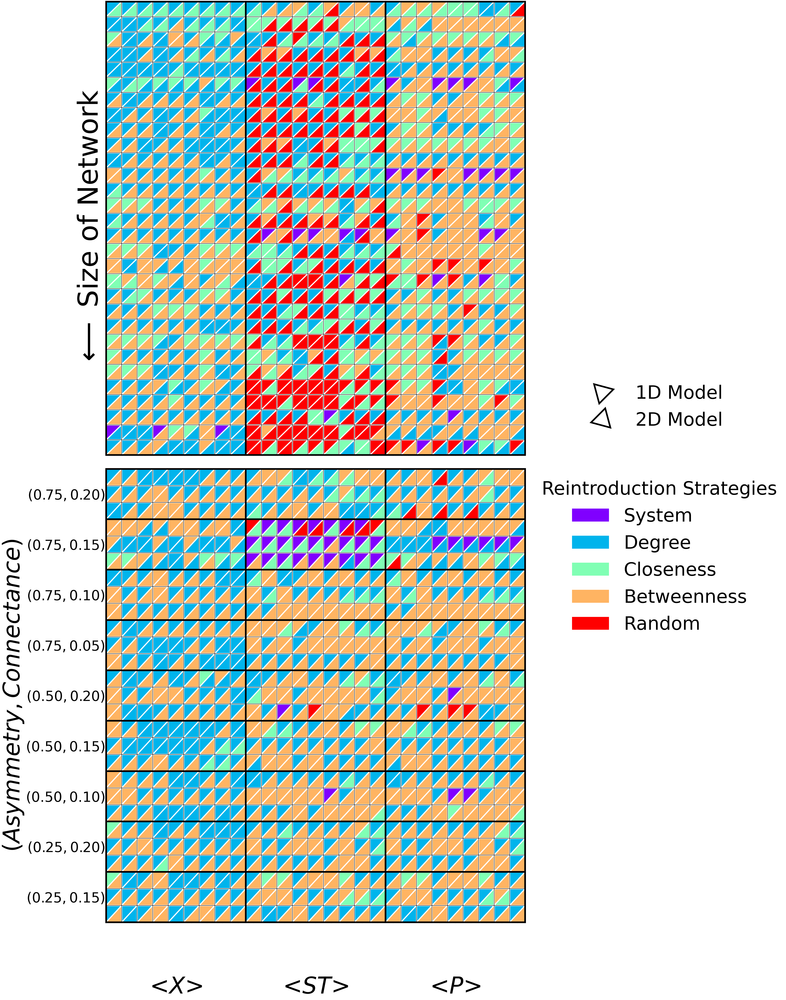

In [4]:
c = {0:'y', 1:'green', 2:'cyan', 3: 'magenta', 4:'orange'}
# fig, ax = plt.subplots(2,1,figsize = (27,27+30), sharex = True)
fig, ax = plt.subplots(2,1,figsize = (27,27+30), sharex = True, dpi = 100)
fig.tight_layout(pad=5)

X = [UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '06_Figures', 'Final_Mask_Per_Real_1D.pkl')),
     UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '06_Figures', 'Final_Mask_Per_Real_2D.pkl'))]
Plot_Heatmap(X, Placeholder = 'Real', Form = 1, ax = ax[0])

X = [UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '06_Figures', 'Final_Mask_Per_Syn_1D.pkl')),
     UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '06_Figures', 'Final_Mask_Per_Syn_2D.pkl'))]
Plot_Heatmap(X, Placeholder = 'Syn', Form = 1, ax = ax[1])

# fig.text(-0.25, 0.25, r"Synthetic Networks", va='center', ha='center',rotation = 90, fontsize=100, style='italic', bbox = dict(boxstyle='round', edgecolor='k', linewidth = 7, facecolor = 'none', alpha=1.0))
# fig.text(-0.25, 0.75, r"Real Networks", va='center', ha='center',rotation = 90, fontsize=100, style='italic', bbox = dict(boxstyle='round', edgecolor='k', linewidth = 7, facecolor = 'none', alpha=1.0))

import matplotlib
from matplotlib.patches import Polygon
cmap = plt.get_cmap('rainbow', 5)
norm = matplotlib.colors.Normalize(vmin=0, vmax=4)

legend_elements = [
    Patch(facecolor=cmap(norm(0)), label='System'),
    Patch(facecolor=cmap(norm(1)), label='Degree'),
    Patch(facecolor=cmap(norm(2)), label='Closeness'),
    Patch(facecolor=cmap(norm(3)), label='Betweenness'),
    Patch(facecolor=cmap(norm(4)), label='Random')
    ]
l1 = ax[1].legend(handles=legend_elements, bbox_to_anchor = [1.0,0.6], loc = 'lower left', title = 'Reintroduction Strategies', fontsize = 80, frameon = False, ncol = 1)
l1.get_title().set_fontsize(80)
legend_elements = [
    Line2D([0], [0], marker=(3,0,45), color='w', label='1D Model', markerfacecolor=None, markersize=100, markeredgecolor = 'k', markeredgewidth=7),
    Line2D([0], [0], marker=(3,0,-15), color='w', label='2D Model', markerfacecolor='None', markersize=100, markeredgecolor = 'k', markeredgewidth=7),
    ]
l2 = ax[1].legend(handles=legend_elements, bbox_to_anchor = [1.1,0.55+0.5], loc = 'lower left', title = ' ', fontsize = 80, frameon = False, ncol = 1)
l2.get_title().set_fontsize(80)
ax[1].add_artist(l1)